# Computer Vision Lab - Transfer learning 

This notebook covers:

1. Data Augmentation - Creating a dataset from a single image
2. Transfer learning to classify the hymenoptera dataset
   1. Retraining the whole network
   2. Fine tuning the network by freezing the weights and retraining the final layers 
   3. Reconstruction and training of a successful architecture (AlexNet) 

Work in this notebook is based on the one provided for the [lab](https://github.com/aeau/MAU-AML-labs/blob/develop/1-computer-vision-lab/1-transfer-learning.ipynb)

## Imports & Setup

In [1]:
import torch
import torchvision
import os
import sys

import numpy as np
import torch.nn as nn
import torch.optim as optim
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objects as go

from PIL import Image
from torchvision import datasets, models, transforms
from plotly.subplots import make_subplots
from torch.optim import lr_scheduler


# importing helpers 
sys.path.insert(1, os.pardir)
from src.helpers import count_parameters, plot_train_test_loss, plot_images

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


## Data Augmentation 

We will use an image of a Super Mario level to create a dataset. This is based on the pyTorch data augmentation [tutorial](https://pytorch.org/vision/main/auto_examples/plot_transforms.html#sphx-glr-auto-examples-plot-transforms-py)

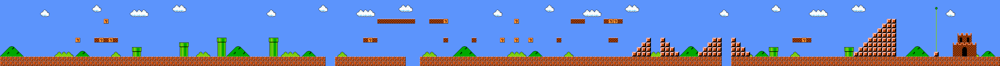

In [2]:
# We start by loading and displaying the image 

img_dir = os.path.join(os.pardir, 'data', 'raw_mario')
img_pth = os.path.join(img_dir, 'mario1-1.png')

img = Image.open(img_pth, mode = 'r')
img = img.convert('RGB')
display(img)

Now we augment this image 
- We will make 224 x 224 x 4 images
- Apply a random rotation 
- Apply a random colour invert 
- Apply a Colour Jitter

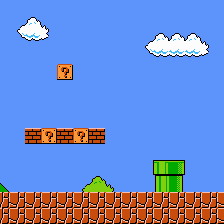

In [3]:
n_generate = 10

# Cropping images 
cropper = transforms.RandomCrop(size=(224, 224))
transformed_images = [cropper(img) for _ in range(n_generate)]

display(transformed_images[0])

# Apply a rand rotation to each image 
rotater = transforms.RandomRotation(degrees=(0, 180))
transformed_images = [rotater(i) for i in transformed_images]

# Blur 
blurrer = transforms.GaussianBlur(kernel_size=(5, 9), sigma=(0.1, 5))
transformed_images = [rotater(i) for i in transformed_images]

# Jitter
jitter = transforms.ColorJitter(brightness=.5, hue=.3)
transformed_images = [jitter(i) for i in transformed_images]


fig = make_subplots(rows=2, cols=3)

fig.add_trace(go.Image(z=transformed_images[0]), 1, 1)
fig.add_trace(go.Image(z=transformed_images[1]), 1, 2)
fig.add_trace(go.Image(z=transformed_images[2]), 1, 3)
fig.add_trace(go.Image(z=transformed_images[3]), 2, 1)
fig.add_trace(go.Image(z=transformed_images[4]), 2, 2)
fig.add_trace(go.Image(z=transformed_images[4]), 2, 3)


Another option is to use a predefined policy such as the data augmentation policy used for ImgeNet (note we do need to crop the images to the desired size)

In [4]:
# ImageNet augmentations 
imgnet_augmenter = transforms.AutoAugment(transforms.AutoAugmentPolicy.IMAGENET)

# Cropping images 
cropper = transforms.RandomCrop(size=(224, 224))
transformed_images = [cropper(img) for _ in range(n_generate)]

transformed_images = [imgnet_augmenter(i) for i in transformed_images]

fig = make_subplots(rows=2, cols=3)

fig.add_trace(go.Image(z=transformed_images[0]), 1, 1)
fig.add_trace(go.Image(z=transformed_images[1]), 1, 2)
fig.add_trace(go.Image(z=transformed_images[2]), 1, 3)
fig.add_trace(go.Image(z=transformed_images[3]), 2, 1)
fig.add_trace(go.Image(z=transformed_images[4]), 2, 2)
fig.add_trace(go.Image(z=transformed_images[5]), 2, 3)

## Transfer Learning on hymenoptera dataset

In this section we apply the concepts of transfer learning to classify ants and bees in the hymenoptera dataset.

### Loading & Augmenting Data

In [5]:
data_transforms = {
    'train': transforms.Compose([
        transforms.RandomResizedCrop(224),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'val': transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}

data_dir = os.path.join(os.pardir, 'data', 'hymenoptera_data')
image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x), data_transforms[x]) for x in ['train', 'val']}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=4, shuffle=True, num_workers=4) for x in ['train', 'val']}

dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'val']}
class_names = image_datasets['train'].classes

In [6]:
# Get a batch of training data
inputs, classes = next(iter(dataloaders['train']))

# Make a grid from batch
out = torchvision.utils.make_grid(inputs)

plot_images(out, title=', '.join([class_names[x] for x in classes]))

### Defining training and testing functions

In [7]:
def train_model(model, criterion, optimizer, device):
    model.train()   
    running_loss = 0.0
    running_corrects = 0
    
    for inputs, labels in dataloaders['train']:
        inputs = inputs.to(device)
        labels = labels.to(device)
    
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        loss = criterion(outputs, labels)
        
        # zero the parameter gradients
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        running_loss += loss.item() * inputs.size(0)
        running_corrects += torch.sum(preds == labels.data)
        
    epoch_loss = running_loss / dataset_sizes['train']
    epoch_acc = running_corrects.double() / dataset_sizes['train']

    print(f'train Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

def test_model(model, criterion, device):
    model.eval()
    running_loss = 0.0
    running_corrects = 0
    
    for inputs, labels in dataloaders['val']:
        inputs = inputs.to(device)
        labels = labels.to(device)
    
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        loss = criterion(outputs, labels)
        
        running_loss += loss.item() * inputs.size(0)
        running_corrects += torch.sum(preds == labels.data)
        
    epoch_loss = running_loss / dataset_sizes['val']
    epoch_acc = running_corrects.double() / dataset_sizes['val']

    print(f'test Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

def fit(model, device, n_epochs):

    model = model.to(device)

    criterion = nn.CrossEntropyLoss()
    optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)
    scheduler = lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

    for epoch in range(n_epochs):
        print(f'Epoch {epoch+1}/{n_epochs}\n')
        train_model(model, criterion, optimizer, device)
        test_model(model, criterion, device)
        scheduler.step()


def visualize_model(model, num_images=6):
    model.eval()
    images_so_far = 0
    fig = plt.figure()

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['val']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                images_so_far += 1 
                title = f'{class_names[preds[j]]}({class_names[labels[j]]})'
                plot_images(inputs.cpu().data[j], title)

                if images_so_far == num_images:
                    return

### Transfer learning from Resnet 18

#### Retraining the whole network

In [8]:
model = models.resnet18(pretrained=True)

fc_input = model.fc.in_features
model.fc = nn.Linear(fc_input, len(class_names))

fit(model, device, 10)


Epoch 1/10

train Loss: 0.7361 Acc: 0.6189
test Loss: 0.2240 Acc: 0.9085
Epoch 2/10

train Loss: 0.4227 Acc: 0.8074
test Loss: 0.1810 Acc: 0.9281
Epoch 3/10

train Loss: 0.3687 Acc: 0.8361
test Loss: 0.3229 Acc: 0.8954
Epoch 4/10

train Loss: 0.4774 Acc: 0.7951
test Loss: 0.3701 Acc: 0.9020
Epoch 5/10

train Loss: 0.8327 Acc: 0.7500
test Loss: 0.3356 Acc: 0.8889
Epoch 6/10

train Loss: 0.4508 Acc: 0.8197
test Loss: 0.3317 Acc: 0.9150
Epoch 7/10

train Loss: 0.4566 Acc: 0.8279
test Loss: 0.2175 Acc: 0.9020
Epoch 8/10

train Loss: 0.3269 Acc: 0.8361
test Loss: 0.3162 Acc: 0.8627
Epoch 9/10

train Loss: 0.3245 Acc: 0.8607
test Loss: 0.1899 Acc: 0.9281
Epoch 10/10

train Loss: 0.2884 Acc: 0.8975
test Loss: 0.2195 Acc: 0.9281


In [9]:
visualize_model(model, 3)

<Figure size 432x288 with 0 Axes>

#### Training only final layer 

In [10]:
model = models.resnet18(pretrained=True)

# freezing weights 
for param in model.parameters():
    param.requires_grad = False

fc_input = model.fc.in_features
model.fc = nn.Linear(fc_input, len(class_names))

fit(model, device, 10)

Epoch 1/10

train Loss: 0.5916 Acc: 0.6639
test Loss: 0.3331 Acc: 0.8562
Epoch 2/10

train Loss: 0.5564 Acc: 0.7500
test Loss: 0.2152 Acc: 0.9281
Epoch 3/10

train Loss: 0.5102 Acc: 0.7582
test Loss: 0.1896 Acc: 0.9346
Epoch 4/10

train Loss: 0.3777 Acc: 0.8115
test Loss: 0.1860 Acc: 0.9412
Epoch 5/10

train Loss: 0.6572 Acc: 0.7459
test Loss: 0.4191 Acc: 0.8431
Epoch 6/10

train Loss: 0.5563 Acc: 0.7664
test Loss: 0.1945 Acc: 0.9412
Epoch 7/10

train Loss: 0.5439 Acc: 0.7787
test Loss: 0.2766 Acc: 0.9150
Epoch 8/10

train Loss: 0.4649 Acc: 0.8074
test Loss: 0.1808 Acc: 0.9477
Epoch 9/10

train Loss: 0.4363 Acc: 0.8033
test Loss: 0.1858 Acc: 0.9477
Epoch 10/10

train Loss: 0.3668 Acc: 0.8320
test Loss: 0.1785 Acc: 0.9542


In [11]:
visualize_model(model, 3)

<Figure size 432x288 with 0 Axes>

#### Replicating AlexNet

In [12]:
models.alexnet()

AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features=9216, out_features=4096, bias=True)
 

In [13]:
class ReplicatedAlexNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.features = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=(11,11), stride=(4, 4), padding=(2, 2)),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False),
            nn.Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2)),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False),
            nn.Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
            nn.ReLU(inplace=True),
            nn.Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
        )
        self.avgpool = nn.AdaptiveAvgPool2d(output_size=(6, 6))
        self.classifier = nn.Sequential(
            nn.Dropout(p=0.5, inplace=False),
            nn.Linear(in_features=9216, out_features=4096, bias=True),
            nn.ReLU(inplace=True),
            nn.Dropout(p=0.5, inplace=False),
            nn.Linear(in_features=4096, out_features=4096, bias=True),
            nn.ReLU(inplace=True),
            nn.Linear(in_features=4096, out_features=2, bias=True)
        )

    def forward(self, x):
        x = self.features(x)
        x = self.avgpool(x)
        x = torch.flatten(x, 1)
        x = self.classifier(x)
        return x

print(ReplicatedAlexNet())

ReplicatedAlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features=9216, out_features=4096, bi

In [14]:
model = ReplicatedAlexNet()
fit(model, device, 10)

Epoch 1/10

train Loss: 0.6938 Acc: 0.5164
test Loss: 0.6938 Acc: 0.4575
Epoch 2/10

train Loss: 0.6935 Acc: 0.4754
test Loss: 0.6919 Acc: 0.5490
Epoch 3/10

train Loss: 0.6932 Acc: 0.4754
test Loss: 0.6934 Acc: 0.4575
Epoch 4/10

train Loss: 0.6922 Acc: 0.5451
test Loss: 0.6919 Acc: 0.6013
Epoch 5/10

train Loss: 0.6930 Acc: 0.5082
test Loss: 0.6908 Acc: 0.6928
Epoch 6/10

train Loss: 0.6920 Acc: 0.5533
test Loss: 0.6908 Acc: 0.6144
Epoch 7/10

train Loss: 0.6913 Acc: 0.5369
test Loss: 0.6876 Acc: 0.5817
Epoch 8/10

train Loss: 0.6905 Acc: 0.5287
test Loss: 0.6875 Acc: 0.5817
Epoch 9/10

train Loss: 0.6909 Acc: 0.5615
test Loss: 0.6876 Acc: 0.6013
Epoch 10/10

train Loss: 0.6911 Acc: 0.5164
test Loss: 0.6875 Acc: 0.6144


In [15]:
visualize_model(model, 3)

<Figure size 432x288 with 0 Axes>

: 